In [1]:
# from https://github.com/JentGent/pitch-shift
# https://www.youtube.com/watch?v=PjKlMXhxtTM

In [2]:
import librosa # https://librosa.org/doc/latest/tutorial.html
import numpy as np
import IPython.display as idisplay
import matplotlib.pyplot as plt

In [3]:
waveform, sr = librosa.load("yur.aiff", sr=None, mono=True)
#waveform.shape
og_len = waveform.shape
print(waveform.shape, sr)
print(max(waveform), min(waveform))
idisplay.display(idisplay.Audio(waveform, rate=sr))

(13242,) 22050
0.7937317 -0.65270996


N:13242, T:0.6005442176870748, DT:0.00005
13242 13242
(13242,) 22050 0.6005442176870748 4.535147392290249e-05


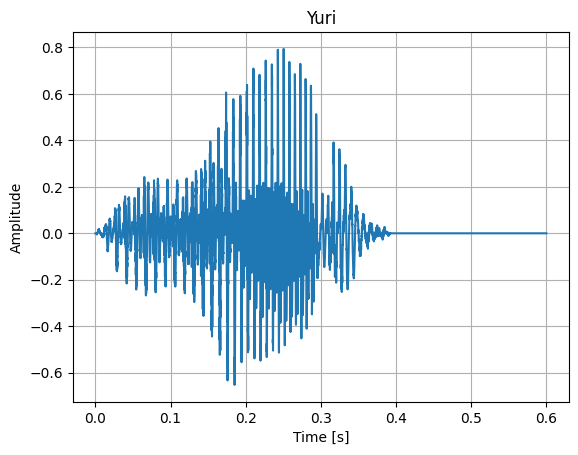

In [4]:
#t, y = sig.step(lti)
N = len(waveform)

T = N / sr
N = len(waveform)
DT = T/N
print(f"N:{N}, T:{T}, DT:{DT:.5f}")

t = np.linspace(0, T, N)
print(len(waveform), len(t))

print(og_len, sr, T, DT)
plt.plot(t, waveform)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title('Yuri')
plt.grid()

In [5]:
# https://notebook.community/mholtrop/Phys605/Python/FFT/FFT+example1
from scipy.fftpack import fft, ifft, fftfreq, fftshift, ifftshift

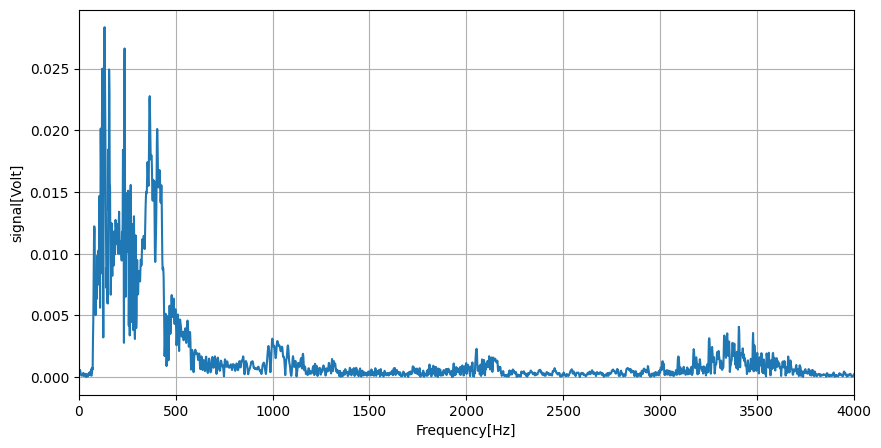

In [6]:
f_fft = fftshift(fftfreq(N,DT))  # Calculate the frequencies, and shift so that f=0Hz is in the center.
y_fft = fftshift(fft(waveform))         # Calculate the FFT, and also shift so that f=0Hz is in the center.

plt.figure(figsize=(10,5))
plt.plot(f_fft,2./N*np.abs(y_fft)) # Note: the 2./N properly normalizes the FFT amplitude to be in Volts.
plt.grid(True)
ax = plt.gca()
ax.set_xlim(0,4000)        # Zoom in: plot only from 0 to 30 Hz.
#plt.yscale("log")      # Uncomment these to get a log-y scale.
#ax.set_ylim(1e-4,1)
plt.xlabel("Frequency[Hz]",position=(0.95,1))
plt.ylabel("signal[Volt]",position=(1,0.8))
plt.show()

In [7]:
waveform2 = librosa.effects.pitch_shift(waveform, sr=sr, n_steps=15)
idisplay.display(idisplay.Audio(waveform2, rate=sr))

13242 13242
(13242,) 22050 0.6005442176870748 4.535147392290249e-05


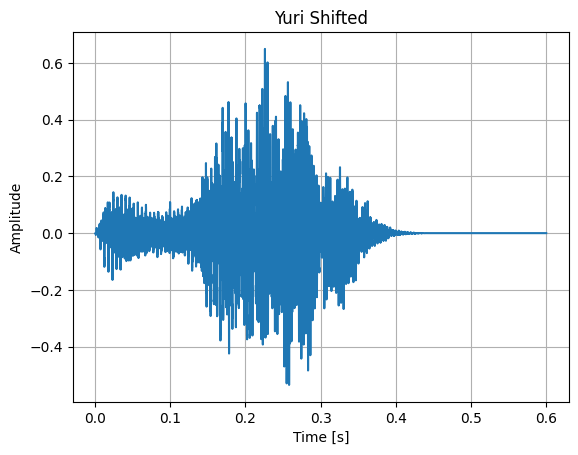

In [8]:
t = np.linspace(0, T, N)
print(len(waveform2), len(t))

print(og_len, sr, T, DT)
plt.plot(t, waveform2)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title('Yuri Shifted')
plt.grid()

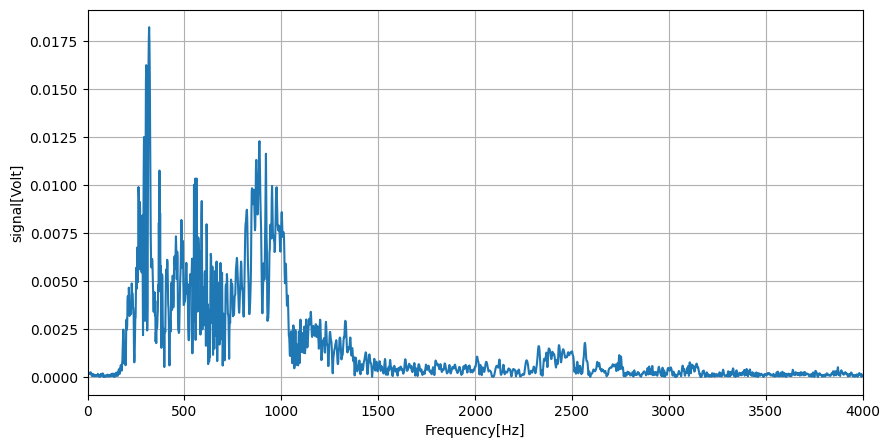

In [9]:
f_fft = fftshift(fftfreq(N,DT))  # Calculate the frequencies, and shift so that f=0Hz is in the center.
y_fft = fftshift(fft(waveform2))         # Calculate the FFT, and also shift so that f=0Hz is in the center.

plt.figure(figsize=(10,5))
plt.plot(f_fft,2./N*np.abs(y_fft)) # Note: the 2./N properly normalizes the FFT amplitude to be in Volts.
plt.grid(True)
ax = plt.gca()
ax.set_xlim(0, 4000)        # Zoom in: plot only from 0 to 30 Hz.
#plt.yscale("log")      # Uncomment these to get a log-y scale.
#ax.set_ylim(1e-4,1)
plt.xlabel("Frequency[Hz]",position=(0.95,1))
plt.ylabel("signal[Volt]",position=(1,0.8))
plt.show()

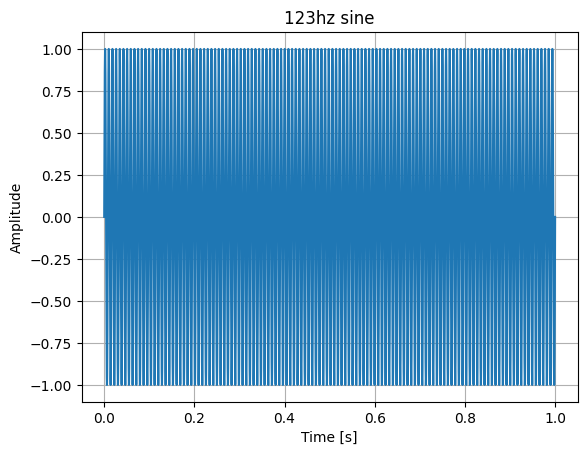

In [10]:
#https://upload.wikimedia.org/wikipedia/commons/a/ad/Piano_key_frequencies.png
#https://en.wikipedia.org/wiki/Piano_key_frequencies    

hz = 123 #  B2
#hz = 262 #  C4
# my vocal range is about B2 to C4
sr = 22050
t = np.linspace(0, 1, sr)
waveform = np.sin(2*np.pi*t*hz)
plt.plot(t, waveform)
plt.xlabel('Time [s]')
plt.ylabel('Amplitude')
plt.title(f'{hz}hz sine')
plt.grid()

idisplay.display(idisplay.Audio(waveform, rate=sr))



N:22050, T:1, DT:0.00005


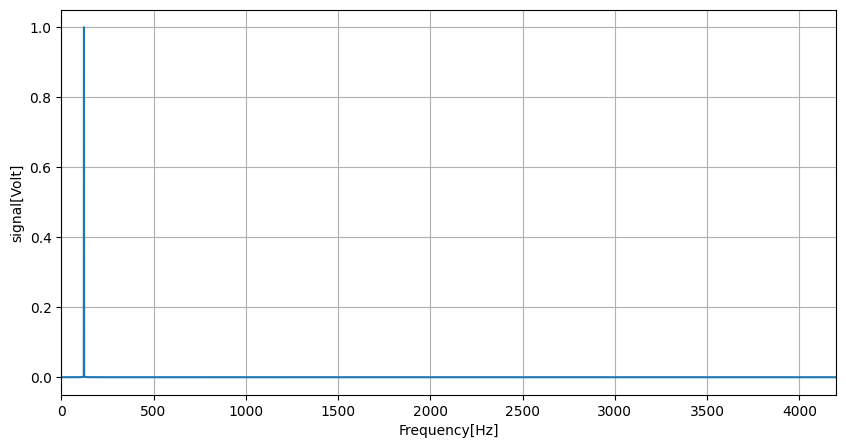

In [11]:
N = len(waveform)
T = 1
DT = T/N
print(f"N:{N}, T:{T}, DT:{DT:.5f}")

f_fft = fftshift(fftfreq(N,DT))  # Calculate the frequencies, and shift so that f=0Hz is in the center.
y_fft = fftshift(fft(waveform))         # Calculate the FFT, and also shift so that f=0Hz is in the center.

plt.figure(figsize=(10,5))
plt.plot(f_fft,2./N*np.abs(y_fft)) # Note: the 2./N properly normalizes the FFT amplitude to be in Volts.
plt.grid(True)
ax = plt.gca()
# piano range is approximately 27 to 4200
ax.set_xlim(0,4200)        # Zoom in: plot only from 0 to 4200 Hz.
#plt.yscale("log")      # Uncomment these to get a log-y scale.
#ax.set_ylim(1e-4,1)
plt.xlabel("Frequency[Hz]",position=(0.95,1))
plt.ylabel("signal[Volt]",position=(1,0.8))
plt.show()

In [12]:
F = 5.
T = 20.     # The length of time determines the resolution of the FFT: how many bins per Hz.
N = 10001   # The total number of points determines the resolution in time: bins per sec. 
            # This translates to the highest available frequency on the FFT
N=  2**20 # In general FFTs go faster if you do them over 2 to the power N points.
DT = T/N
t = np.linspace(0.,T,N)
t[0:5]

array([0.00000000e+00, 1.90735045e-05, 3.81470090e-05, 5.72205136e-05,
       7.62940181e-05])

In [13]:
y = 2.*np.sin(2*np.pi*F*t)+1.*np.sin(2*np.pi*2*F*t)++0.5*np.sin(2*np.pi*4*F*t)

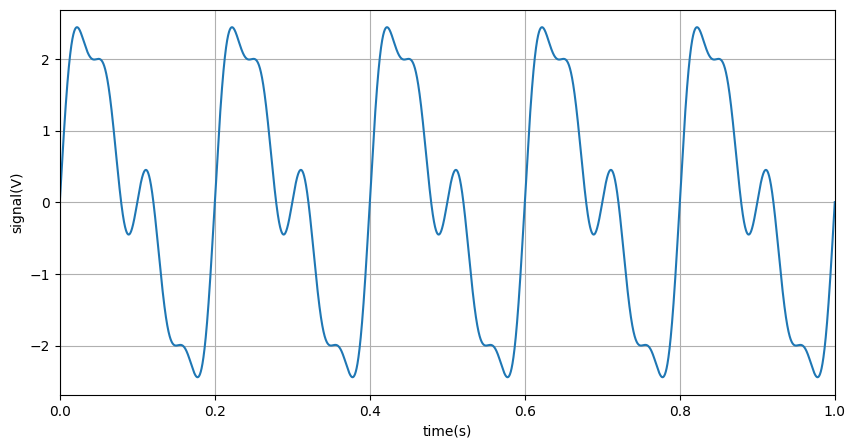

In [14]:
plt.figure(figsize=(10,5))
plt.plot(t,y)
plt.grid(True)
plt.xlabel("time(s)",position=(0.95,1))
plt.ylabel("signal(V)",position=(1,0.9))
ax = plt.gca()
ax.set_xlim(0.,1.)
plt.show()

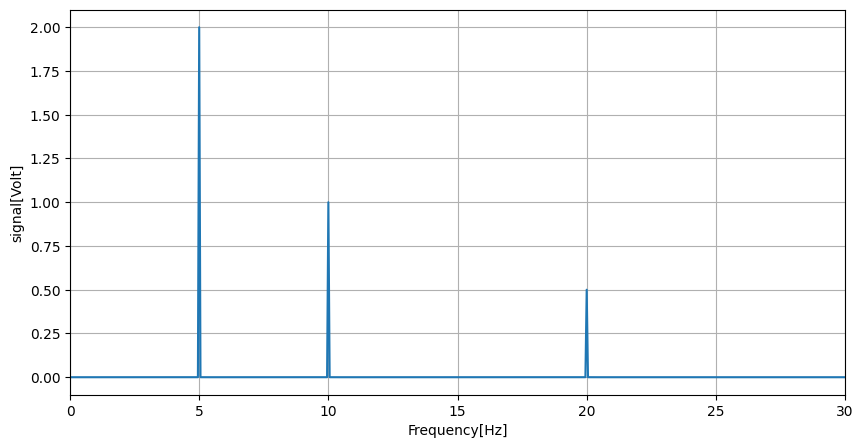

In [15]:
f_fft = fftshift(fftfreq(N,DT))  # Calculate the frequencies, and shift so that f=0Hz is in the center.
y_fft = fftshift(fft(y))         # Calculate the FFT, and also shift so that f=0Hz is in the center.
plt.figure(figsize=(10,5))
plt.plot(f_fft,2./N*np.abs(y_fft)) # Note: the 2./N properly normalizes the FFT amplitude to be in Volts.
plt.grid(True)
ax = plt.gca()
ax.set_xlim(0,30)        # Zoom in: plot only from 0 to 30 Hz.
# plt.yscale("log")      # Uncomment these to get a log-y scale.
# ax.set_ylim(1e-4,1)
plt.xlabel("Frequency[Hz]",position=(0.95,1))
plt.ylabel("signal[Volt]",position=(1,0.8))
plt.show()

In [16]:
waveform, sr = librosa.load("audio.wav", sr=None, mono=False)
channels, og_len = waveform.shape
print(waveform.shape, sr)
# idisplay.display(idisplay.Audio(waveform, rate=sr))
idisplay.display(idisplay.Audio(waveform, rate=sr * 2))

(2, 286650) 44100


# OLA

## direct pitch shift

### OLA

In [17]:
anls_win_len = 5000 # / 44100 = 113.3786848 ms
anls_hop_len = 2000 # / 44100 = 45.35147392 ms
scaling = 2 ** (5 / 12)
synth_hop_len = anls_hop_len
synth_win_len = int(anls_win_len // scaling)
win_f = np.hanning(synth_win_len)

new_waveform_len = int(np.ceil(og_len / anls_hop_len) * synth_hop_len) + synth_win_len
new_waveform = np.zeros((channels, new_waveform_len)) # stereo audio
new_scales = np.zeros(new_waveform_len)

# loop through windows
for i in range(0, og_len, anls_hop_len):
    clipped_len = min(i + anls_win_len, og_len - 2) - i
    
    # stretch to synth_win_len. see how this interpolation could lose information
    idxs = np.linspace(i, i + clipped_len, synth_win_len)
    start = idxs.astype(int)
    frac = idxs - start
    window = waveform[:, start] * (1 - frac) + waveform[:, start + 1] * frac

    # add window to new waveform
    new_waveform[:, i:i + synth_win_len] += window * win_f[None, :]
    # add up windowing weights for normalization
    new_scales[i:i + synth_win_len] += win_f[:]

new_waveform = new_waveform / np.where(new_scales == 0, 1, new_scales)

idisplay.display(idisplay.Audio(new_waveform, rate=sr))

### SOLA

In [18]:
anls_win_len = 5000 # / 44100 = 113.3786848 ms
anls_hop_len = 2000 # / 44100 = 45.35147392 ms
scaling = 2 ** (5 / 12)
synth_hop_len = anls_hop_len
synth_win_len = int(anls_win_len // scaling)
win_f = np.hanning(synth_win_len)

new_waveform_len = int(np.ceil(og_len / anls_hop_len) * synth_hop_len) + synth_win_len
new_waveform = np.zeros((channels, new_waveform_len)) # stereo audio
norm_new_waveform = np.zeros((channels, new_waveform_len))
new_scales = np.zeros(new_waveform_len)

# loop through windows
last_idx = 0
for i in range(0, og_len, anls_hop_len):
    clipped_len = min(i + anls_win_len, og_len - 2) - i
    
    # stretch to synth_win_len. see how this interpolation could lose information
    idxs = np.linspace(i, i + clipped_len, synth_win_len)
    start = idxs.astype(int)
    frac = idxs - start
    window = waveform[:, start] * (1 - frac) + waveform[:, start + 1] * frac
    window = window * win_f[None, :]

    idx = i
    # search for good synthesis window placement
    if idx > 0:
        idx = max(0, idx - 500)
        overlap = max(0, min(synth_win_len - idx + last_idx, new_waveform_len - idx, window.shape[1]))
        min_area = float("inf")
        for j in range(idx, min(idx + 1000, new_waveform_len - window.shape[1], idx + overlap)):
            # area = np.sum(np.abs(window[:, :overlap] - new_waveform[:, j:j + overlap])) / overlap
            area = -np.sum(window[:, :overlap] * norm_new_waveform[:, j:j + overlap])
            if area < min_area:
                min_area = area
                idx = j
            overlap -= 1
            if not overlap: break

    # add window to new waveform
    window_waveform = new_waveform[:, idx:idx + synth_win_len]
    window_waveform += window
    # add up windowing weights for normalization
    window_scales = new_scales[idx:idx + synth_win_len]
    window_scales += win_f[:synth_win_len]
    norm_new_waveform[:, idx:idx + synth_win_len] = window_waveform / np.where(window_scales == 0, 1, window_scales)
    
    last_idx = idx

new_waveform = norm_new_waveform

idisplay.display(idisplay.Audio(new_waveform, rate=sr))

### didn't do WSOLA direct pitch shift because you'd need to stretch each analysis window for each time lag you search

## time scale, playback rate change

### OLA

In [19]:
win_len = 5000 # / 44100 = 113.3786848 ms
win_f = np.hanning(win_len)
anls_hop_len = 2000 # / 44100 = 45.35147392 ms
scaling = 2 ** (5 / 12)
synth_hop_len = int(anls_hop_len * scaling)

new_waveform_len = int(np.ceil(og_len / anls_hop_len) * synth_hop_len) + win_len
new_waveform = np.zeros((channels, new_waveform_len)) # stereo audio
new_scales = np.zeros(new_waveform_len)

# loop through windows
for i in range(0, og_len, anls_hop_len):
    clipped_len = min(win_len, og_len - i)
    
    idx = int(i * scaling)

    # add window to new waveform
    new_waveform[:, idx:idx + clipped_len] += waveform[:, i:i + clipped_len] * win_f[None, :clipped_len]
    # add up windowing weights for normalization
    new_scales[idx:idx + clipped_len] += win_f[:clipped_len]

new_waveform = new_waveform / np.where(new_scales == 0, 1, new_scales)

idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))

### SOLA

In [20]:
win_len = 5000 # / 44100 = 113.3786848 ms
win_f = np.hanning(win_len)
anls_hop_len = 2000 # / 44100 = 45.35147392 ms
scaling = 2 ** (5 / 12)
synth_hop_len = int(anls_hop_len * scaling)

new_waveform_len = int(np.ceil(og_len / anls_hop_len) * synth_hop_len) + win_len
new_waveform = np.zeros((channels, new_waveform_len)) # stereo audio
norm_new_waveform = np.zeros((channels, new_waveform_len))
new_scales = np.zeros(new_waveform_len)

# loop through windows
last_idx = 0
for i in range(0, og_len, anls_hop_len):
    clipped_len = min(win_len, og_len - i)
    window = waveform[:, i:i + clipped_len] * win_f[None, :clipped_len]

    idx = int(i * scaling)
    # search for good synthesis window placement
    if idx > 0:
        idx = max(0, idx - 500)
        overlap = max(0, min(win_len - idx + last_idx, new_waveform_len - idx, window.shape[1]))
        min_area = float("inf")
        for j in range(idx, min(idx + 1000, new_waveform_len - clipped_len, idx + overlap)):
            # area = np.sum(np.abs(window[:, :overlap] - norm_new_waveform[:, j:j + overlap])) / overlap
            area = -np.sum(window[:, :overlap] * norm_new_waveform[:, j:j + overlap])
            if area < min_area:
                min_area = area
                idx = j
            overlap -= 1
            if not overlap: break

    # add window to new waveform
    window_waveform = new_waveform[:, idx:idx + clipped_len]
    window_waveform += window
    # add up windowing weights for normalization
    window_scales = new_scales[idx:idx + clipped_len]
    window_scales += win_f[:clipped_len]
    norm_new_waveform[:, idx:idx + clipped_len] = window_waveform / np.where(window_scales == 0, 1, window_scales)

    last_idx = idx

new_waveform = norm_new_waveform

idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))

### WSOLA

In [21]:
win_len = 5000 # / 44100 = 113.3786848 ms
win_f = np.hanning(win_len)
anls_hop_len = 2000 # / 44100 = 45.35147392 ms
scaling = 2 ** (5 / 12)
synth_hop_len = int(anls_hop_len * scaling)

new_waveform_len = int(np.ceil(og_len / anls_hop_len) * synth_hop_len) + win_len
new_waveform = np.zeros((channels, new_waveform_len)) # stereo audio
norm_new_waveform = np.zeros((channels, new_waveform_len))
new_scales = np.zeros(new_waveform_len)

# loop through windows
overlap = win_len - synth_hop_len
for i in range(0, og_len, anls_hop_len):
    s_idx = int(i * scaling)

    # search for good analysis window placement
    if i > 0:
        a_idx = max(0, i - 500)
        overlap = max(0, min(win_len - synth_hop_len, new_waveform_len - s_idx, window.shape[1]))
        synth_overlap = norm_new_waveform[:, s_idx:s_idx + overlap] * win_f[None, :overlap]
        min_area = float("inf")
        for j in range(a_idx, min(a_idx + 1000, og_len - clipped_len, a_idx + overlap)):
            area = -np.sum(waveform[:, j:j + overlap] * synth_overlap)
            if area < min_area:
                min_area = area
                a_idx = j
        clipped_len = min(win_len, og_len - a_idx)
        window = waveform[:, a_idx:a_idx + clipped_len] * win_f[None, :clipped_len]
    else:
        clipped_len = win_len
        window = waveform[:, :clipped_len] * win_f[None, :clipped_len]

    # add window to new waveform
    window_waveform = new_waveform[:, s_idx:s_idx + clipped_len]
    window_waveform += window
    # add up windowing weights for normalization
    window_scales = new_scales[s_idx:s_idx + clipped_len]
    window_scales += win_f[:clipped_len]
    # one of the main justifications of WSOLA in the original paper was that because the synthesis hop size is constant, the window normalization factor is constant across windows, which gives a significant performance boost ... nowadays, that is negligible, so i didn't even bother (and if i cared about performance, i wouldn't have used python)
    norm_new_waveform[:, s_idx:s_idx + clipped_len] = window_waveform / np.where(window_scales == 0, 1, window_scales)

new_waveform = norm_new_waveform

idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))

# Phase vocoder

In [22]:
def show_sgram(stft, hop_len, n_fft):
    fig, ax = plt.subplots()
    sgram = librosa.display.specshow(librosa.amplitude_to_db(np.abs(stft[0, :, :]), ref=np.max), sr=sr, hop_length=hop_len, n_fft=n_fft, win_length=win_len, x_axis="time", y_axis="linear", ax=ax)
    fig.colorbar(sgram, ax=ax, format="%+2.f dB")

In [23]:
def interpolate_freq(idxs: np.ndarray, arr):
    start = idxs.astype(int)
    frac = (idxs - start)[None, :, None]
    shifted_arr = np.concatenate((arr[:, 1:, :], np.zeros((arr.shape[0], 1, arr.shape[2]))), axis=1)
    return arr[:, start, :] * (1 - frac) + shifted_arr[:, start, :] * frac

In [24]:
def round_interpolate_freq(idxs: np.ndarray, arr):
    return arr[:, (idxs + 0.5).astype(int), :]

In [25]:
def interpolate_time(idxs: np.ndarray, arr):
    start = (idxs + 0.5).astype(int)
    frac = (idxs - start)[None, None, :]
    shifted_arr = np.concatenate((arr[:, :, 1:], np.zeros((arr.shape[0], arr.shape[1], 1))), axis=2)
    return arr[:, :, start] * (1 - frac) + shifted_arr[:, :, start] * frac

In [26]:
def round_interpolate_time(idxs: np.ndarray, arr):
    return arr[:, :, (idxs + 0.5).astype(int)]

In [27]:
win_len = 4096 # FFT works best with powers of 2
n_fft = 4096
hop_len = 1024
anls_stft = librosa.stft(waveform, n_fft=n_fft, hop_length=hop_len, win_length=win_len)
channels, n_anls_freqs, n_anls_frames = anls_stft.shape
print(anls_stft.shape)
# show_sgram(anls_stft, hop_len, n_fft)

(2, 2049, 280)


## ignore transients

### direct pitch shift (1  more step: subtract bin frequency phase difference; unlike in time stretch, bin freqs change)

In [28]:
scaling = 2 ** (5 / 12)
anls_freqs = np.arange(n_anls_freqs)
n_synth_freqs = int(min(n_anls_freqs, n_anls_freqs * scaling)) # throw away anything above nyquist
synth_freqs = np.arange(n_synth_freqs)
og_idxs = synth_freqs / scaling

aligned_phase_diff = np.pi * 2 * hop_len / win_len

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1]), axis=2)
phase_diffs -= (anls_freqs * aligned_phase_diff)[None, :, None]
phase_diffs = np.mod(phase_diffs + np.pi, np.pi * 2) - np.pi

shifted_mags = interpolate_freq(og_idxs, mags)
shifted_phase_diffs = interpolate_freq(og_idxs, phase_diffs) * scaling

shifted_phase_diffs += (synth_freqs * aligned_phase_diff)[None, :, None]

shifted_phases = np.cumsum(shifted_phase_diffs, axis=2)

synth_stft = shifted_mags * np.exp(shifted_phases * 1j)
# if we threw away any frequencies, pad with zeros
synth_stft = np.concatenate((synth_stft, np.zeros((channels, n_anls_freqs - n_synth_freqs, n_anls_frames))), axis=1)

new_waveform = librosa.istft(synth_stft, hop_length=hop_len, win_length=win_len, n_fft=n_fft)
idisplay.display(idisplay.Audio(new_waveform, rate=sr))
# show_sgram(synth_stft, hop_len, n_fft)

### scale hop length (technique described by Laroche and Dolson in 1997 introduces slight amplitude modulation)

In [29]:
scaling = 2 ** (5 / 12)
freqs = np.arange(n_anls_freqs)
synth_hop_len = int(hop_len * scaling)
scaling = synth_hop_len / hop_len

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_offset = (synth_hop_len - hop_len) / win_len * np.pi * 2
phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1] * scaling), axis=2)
phase_diffs += (phase_offset * freqs)[None, :, None]

shifted_phases = np.cumsum(phase_diffs, axis=2)

synth_stft = mags * np.exp(shifted_phases * 1j)

new_waveform = librosa.istft(synth_stft, hop_length=synth_hop_len, win_length=win_len, n_fft=n_fft, )
idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))

### time scale, playback rate change

In [30]:
scaling = 2 ** (5 / 12)
freqs = np.arange(n_anls_freqs)
anls_frames = np.arange(n_anls_frames)
n_synth_frames = np.floor(n_anls_frames * scaling).astype(int)
synth_frames = np.arange(n_synth_frames)
og_idxs = np.minimum(synth_frames / scaling, n_anls_frames - 1)

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1]), axis=2)
phase_diffs = np.mod(phase_diffs, np.pi * 2)

shifted_mags = interpolate_time(og_idxs, mags)
shifted_phase_diffs = interpolate_time(og_idxs, phase_diffs)

shifted_phases = np.cumsum(shifted_phase_diffs, axis=2)

synth_stft = shifted_mags * np.exp(shifted_phases * 1j)

new_waveform = librosa.istft(synth_stft, hop_length=hop_len, win_length=win_len, n_fft=n_fft)
idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))
# show_sgram(synth_stft, hop_len, n_fft)

## add transients back in

### direct pitch shift (doubled transients; windows repeat because of periodicity? need to cut them off at `win_len / scaling`)

In [31]:
scaling = 2 ** (5 / 12)
anls_freqs = np.arange(n_anls_freqs)
n_synth_freqs = int(min(n_anls_freqs, n_anls_freqs * scaling)) # throw away anything above nyquist
synth_freqs = np.arange(n_synth_freqs)
og_idxs = synth_freqs / scaling

aligned_phase_diff = np.pi * 2 / win_len * hop_len

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1]), axis=2)
phase_diffs -= (anls_freqs * aligned_phase_diff)[None, :, None]
phase_diffs = np.mod(phase_diffs + np.pi, np.pi * 2) - np.pi

shifted_mags = interpolate_freq(og_idxs, mags)
shifted_phase_diffs = interpolate_freq(og_idxs, phase_diffs) * scaling
unshifted_phases = round_interpolate_freq(og_idxs, phases) * scaling

shifted_phase_diffs += (synth_freqs * aligned_phase_diff)[None, :, None]

shifted_phases = np.zeros((channels, n_synth_freqs, n_anls_frames))
shifted_phases[:, :, 0] = shifted_phase_diffs[:, :, 0]
for t in range(1, n_anls_frames):
    time_phases = shifted_phases[:, :, t - 1] + shifted_phase_diffs[:, :, t]
    freq_phases = unshifted_phases[:, :, t]
    transient = (shifted_mags[:, :, t] - shifted_mags[:, :, t - 1]) / (shifted_mags[:, :, t] + shifted_mags[:, :, t - 1])
    transient[transient < 0.5] = 0
    transient[transient >= 0.5] = 1
    shifted_phases[:, :, t] = np.mod(freq_phases * transient + time_phases * (1 - transient), np.pi * 2) # mod for readable phases

synth_stft = shifted_mags * np.exp(shifted_phases * 1j)
# if we threw away any frequencies, pad with zeros
synth_stft = np.concatenate((synth_stft, np.zeros((channels, n_anls_freqs - n_synth_freqs, n_anls_frames))), axis=1)

new_waveform = librosa.istft(synth_stft, hop_length=hop_len, win_length=win_len, n_fft=n_fft)
idisplay.display(idisplay.Audio(new_waveform, rate=sr))
# show_sgram(synth_stft, hop_len, n_fft)

### scale hop length (technique described by Laroche and Dolson in 1997 introduces slight amplitude modulation)

In [32]:
scaling = 2 ** (5 / 12)
freqs = np.arange(n_anls_freqs)
synth_hop_len = int(hop_len * scaling)
scaling = synth_hop_len / hop_len

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_offset = (synth_hop_len - hop_len) / win_len * np.pi * 2
phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1] * scaling), axis=2)
phase_diffs += (phase_offset * freqs)[None, :, None]

shifted_phases = np.zeros((channels, n_anls_freqs, n_anls_frames))
shifted_phases[:, :, 0] = phase_diffs[:, :, 0]
for t in range(1, n_anls_frames):
    time_phases = shifted_phases[:, :, t - 1] + phase_diffs[:, :, t]
    freq_phases = phases[:, :, t] * scaling
    transient = (mags[:, :, t] - mags[:, :, t - 1]) / (mags[:, :, t] + mags[:, :, t - 1])
    transient[transient < 0.5] = 0
    transient[transient >= 0.5] = 1
    shifted_phases[:, :, t] = np.mod(freq_phases * transient + time_phases * (1 - transient), np.pi * 2) # mod for readable phases

synth_stft = mags * np.exp(shifted_phases * 1j)
# synth_stft = anls_stft

new_waveform = librosa.istft(synth_stft, hop_length=synth_hop_len, win_length=win_len, n_fft=n_fft, )
idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))

### time scale, playback rate change

In [33]:
scaling = 2 ** (5 / 12)
freqs = np.arange(n_anls_freqs)
anls_frames = np.arange(n_anls_frames)
n_synth_frames = np.floor(n_anls_frames * scaling).astype(int)
synth_frames = np.arange(n_synth_frames)
og_idxs = np.minimum(synth_frames / scaling, n_anls_frames - 1)

mags = np.abs(anls_stft)
phases = np.angle(anls_stft)

phase_diffs = phases - np.concatenate((np.zeros((channels, n_anls_freqs, 1)), phases[:, :, :-1]), axis=2)
phase_diffs = np.mod(phase_diffs, np.pi * 2)

shifted_mags = interpolate_time(og_idxs, mags)
shifted_phase_diffs = interpolate_time(og_idxs, phase_diffs)
unshifted_phases = round_interpolate_time(og_idxs, phases)

shifted_phases = np.zeros((channels, n_anls_freqs, n_synth_frames))
shifted_phases[:, :, 0] = shifted_phase_diffs[:, :, 0]
for t in range(1, n_synth_frames):
    time_phases = shifted_phases[:, :, t - 1] + shifted_phase_diffs[:, :, t]
    freq_phases = unshifted_phases[:, :, t]
    transient = (shifted_mags[:, :, t] - shifted_mags[:, :, t - 1]) / (shifted_mags[:, :, t] + shifted_mags[:, :, t - 1])
    transient[transient < 0.5] = 0
    transient[transient >= 0.5] = 1
    shifted_phases[:, :, t] = np.mod(freq_phases * transient + time_phases * (1 - transient), np.pi * 2) # mod for readable phases

synth_stft = shifted_mags * np.exp(shifted_phases * 1j)

new_waveform = librosa.istft(synth_stft, hop_length=hop_len, win_length=win_len, n_fft=n_fft)
idisplay.display(idisplay.Audio(new_waveform, rate=sr * scaling))
# show_sgram(synth_stft, hop_len, n_fft)

## librosa built-in

In [34]:
idisplay.display(idisplay.Audio(librosa.effects.time_stretch(waveform, rate=2 ** (-5 / 12)), rate=sr * 2 ** (5 / 12)))

In [35]:
idisplay.display(idisplay.Audio(librosa.effects.pitch_shift(waveform, sr=sr, n_steps=5), rate=sr))